# Creating the environment

In [ ]:
%pip install --upgrade pip
%pip install tensorflow

# Before upgrade
import tensorflow as tf
print(tf.__version__)

%pip install --upgrade tensorflow

# After upgrade
import tensorflow as tf
print(tf.__version__)

In [ ]:
%pip install pydot
%pip install seaborn
%pip install scikit-learn
%pip install scikit-image

# Imports

In [32]:
# Data manipulation libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Essential image data loader libraries
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from PIL import Image
import os

# Model bulding libraries
from tensorflow.keras.models import Sequential, load_model
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Dense, BatchNormalization, Activation, Dropout, Input, LeakyReLU, Flatten
from tensorflow.keras.regularizers import l2
from tensorflow.keras.optimizers import Adam

# Model training balancer libraries
from sklearn.utils.class_weight import compute_class_weight
from tensorflow.keras.callbacks import ReduceLROnPlateau, ModelCheckpoint, EarlyStopping

# Model evaluation libraries
from sklearn.metrics import classification_report, confusion_matrix
from skimage import img_as_float, io

# **Loading entire dataset**

Dataset link - https://www.kaggle.com/datasets/gpiosenka/sports-classification

In [4]:
# Load the CSV file
df = pd.read_csv('./sports.csv')

print(df.head(), end="\n\n")
print(df.describe(include='all'))


   class id                 filepaths      labels data set
0         0  train/air hockey/001.jpg  air hockey    train
1         0  train/air hockey/002.jpg  air hockey    train
2         0  train/air hockey/003.jpg  air hockey    train
3         0  train/air hockey/004.jpg  air hockey    train
4         0  train/air hockey/005.jpg  air hockey    train

            class id                    filepaths    labels data set
count   14493.000000                        14493     14493    14493
unique           NaN                        14493       100        3
top              NaN  valid/wingsuit flying/5.jpg  football    train
freq             NaN                            1       201    13493
mean       49.206375                          NaN       NaN      NaN
std        28.357108                          NaN       NaN      NaN
min         0.000000                          NaN       NaN      NaN
25%        25.000000                          NaN       NaN      NaN
50%        49.000000    

# **Splitting Training, Validation and Test sets**

In [5]:
def remove_corrupted_and_load_image(dataframe, set_no):
    if set_no == 0:
        print("For Training set ->")
    elif set_no == 1:
        print("For Validation set ->")
    else:
        print("For Test set ->")

    # Checking if all the filepaths are valid
    invalid_filepaths = dataframe[~dataframe['filepaths'].apply(lambda x: os.path.exists(os.path.join('', x)))]

    if (invalid_filepaths).values.sum():
        print(invalid_filepaths)
        # Remove the row with the invalid file path
        dataframe = dataframe[dataframe['filepaths'].apply(lambda x: os.path.exists(os.path.join('', x)))]
        print("Invalid paths removed")



    # Checking if all the images are readable
    def is_image_readable(filepath):
        try:
            img = Image.open(filepath)
            img.verify()  # Verify if the file is an image
            return True
        except:
            return False

    # Apply the function to check for unreadable images
    valid_filepath_df = dataframe['filepaths'].apply(lambda x: is_image_readable(os.path.join('', x)))

    # Filter out unreadable images
    unreadable_filepaths = dataframe[valid_filepath_df == False]
    print(unreadable_filepaths)

    # Remove unreadable file paths
    dataframe = dataframe[valid_filepath_df == True]

    print((~valid_filepath_df).values.sum(), "image excluded.")



    # ImageDataGenerator for loading images
    datagen = None
    if set_no == 0:  # trining set
        datagen = ImageDataGenerator(
            rescale=1.0/255,
            rotation_range=5,  # Max 5% rotation
            width_shift_range=0.05,  # Horizontal shift
            height_shift_range=0.05,  # Vertical shift
            horizontal_flip=True,  # Flip images horizontally
            zoom_range=0.02  # Zoom in or out by 2%
        )
    else:
        datagen = ImageDataGenerator(rescale=1.0/255.0)

    # Load images from the combined train and validation set
    if set_no == 0:  # trining set
        data_gen = datagen.flow_from_dataframe(
            dataframe=dataframe,
            directory='',
            x_col='filepaths',
            y_col='labels',
            target_size=(224, 224),
            batch_size=32,
            class_mode='categorical')
    else:
        data_gen = datagen.flow_from_dataframe(
        dataframe=dataframe,
        directory='',
        x_col='filepaths',
        y_col='labels',
        target_size=(224, 224),
        batch_size=32,
        class_mode='categorical',
        shuffle=False)


    print("\n\n\n")
    return (dataframe, data_gen)

In [6]:
# train data
train_df = df[df['data set'].isin(['train'])]

train_df, train_gen = remove_corrupted_and_load_image(train_df, 0)

print(train_df, end = '\n\n')
print(train_gen)

For Training set ->
      class id                filepaths     labels data set
5621        40  train/high jump/159.lnk  high jump    train
1 image excluded.
Found 13492 validated image filenames belonging to 100 classes.




       class id                     filepaths           labels data set
0             0      train/air hockey/001.jpg       air hockey    train
1             0      train/air hockey/002.jpg       air hockey    train
2             0      train/air hockey/003.jpg       air hockey    train
3             0      train/air hockey/004.jpg       air hockey    train
4             0      train/air hockey/005.jpg       air hockey    train
...         ...                           ...              ...      ...
13488        99  train/wingsuit flying/94.jpg  wingsuit flying    train
13489        99  train/wingsuit flying/95.jpg  wingsuit flying    train
13490        99  train/wingsuit flying/96.jpg  wingsuit flying    train
13491        99  train/wingsuit flying/97.jpg  wingsui

In [7]:
# validation data
val_df = df[df['data set'].isin(['valid'])]

val_df, val_gen = remove_corrupted_and_load_image(val_df, 1)

print(val_df, end = '\n\n')
print(val_gen)

For Validation set ->
Empty DataFrame
Columns: [class id, filepaths, labels, data set]
Index: []
0 image excluded.
Found 500 validated image filenames belonging to 100 classes.




       class id                    filepaths           labels data set
13993         0       valid/air hockey/1.jpg       air hockey    valid
13994         0       valid/air hockey/2.jpg       air hockey    valid
13995         0       valid/air hockey/3.jpg       air hockey    valid
13996         0       valid/air hockey/4.jpg       air hockey    valid
13997         0       valid/air hockey/5.jpg       air hockey    valid
...         ...                          ...              ...      ...
14488        99  valid/wingsuit flying/1.jpg  wingsuit flying    valid
14489        99  valid/wingsuit flying/2.jpg  wingsuit flying    valid
14490        99  valid/wingsuit flying/3.jpg  wingsuit flying    valid
14491        99  valid/wingsuit flying/4.jpg  wingsuit flying    valid
14492        99  valid/wingsuit flying

In [8]:
# test data
test_df = df[df['data set'].isin(['test'])]

test_df, test_gen = remove_corrupted_and_load_image(test_df, 2)

print(test_df, end = '\n\n')
print(test_gen)

For Test set ->
Empty DataFrame
Columns: [class id, filepaths, labels, data set]
Index: []
0 image excluded.
Found 500 validated image filenames belonging to 100 classes.




       class id                   filepaths           labels data set
13493         0       test/air hockey/1.jpg       air hockey     test
13494         0       test/air hockey/2.jpg       air hockey     test
13495         0       test/air hockey/3.jpg       air hockey     test
13496         0       test/air hockey/4.jpg       air hockey     test
13497         0       test/air hockey/5.jpg       air hockey     test
...         ...                         ...              ...      ...
13988        99  test/wingsuit flying/1.jpg  wingsuit flying     test
13989        99  test/wingsuit flying/2.jpg  wingsuit flying     test
13990        99  test/wingsuit flying/3.jpg  wingsuit flying     test
13991        99  test/wingsuit flying/4.jpg  wingsuit flying     test
13992        99  test/wingsuit flying/5.jpg  wingsuit f

# **Data visualization**

In [9]:
# Function to visualize images along with their labels
def visualize_images(generator, num_images=9):
    images, labels = next(generator)  # Get a batch of images and labels

    plt.figure(figsize=(10, 10))
    for i in range(num_images):
        plt.subplot(3, 3, i + 1)  # Create a 3x3 grid for visualization
        plt.imshow(images[i])  # Display the image
        plt.axis('off')
        plt.title(labels[i].argmax())  # Display the label (as a number)
    plt.show()


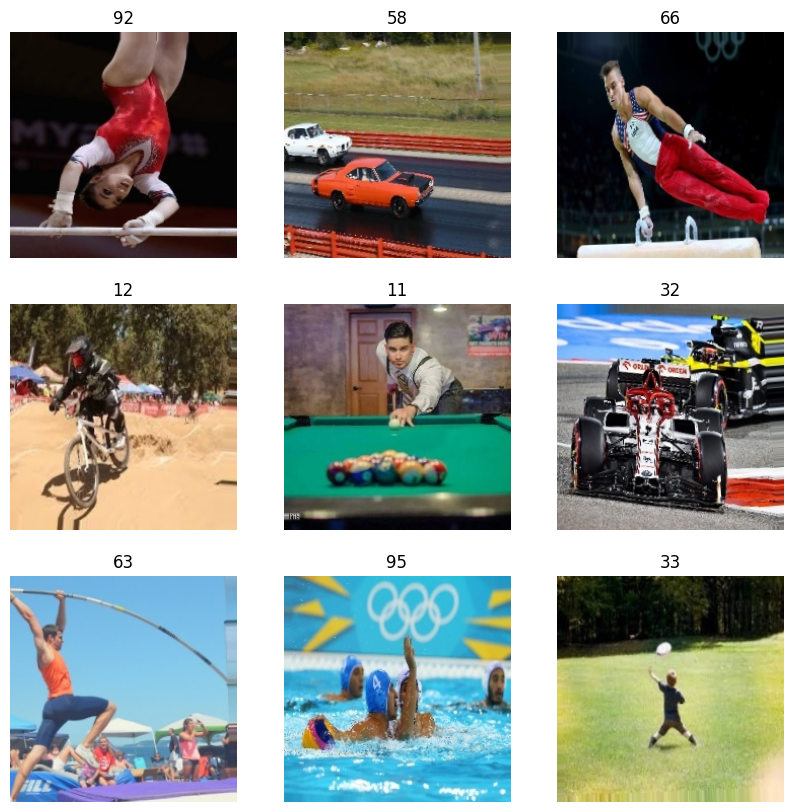

In [10]:
# Visualize training set images
visualize_images(train_gen)

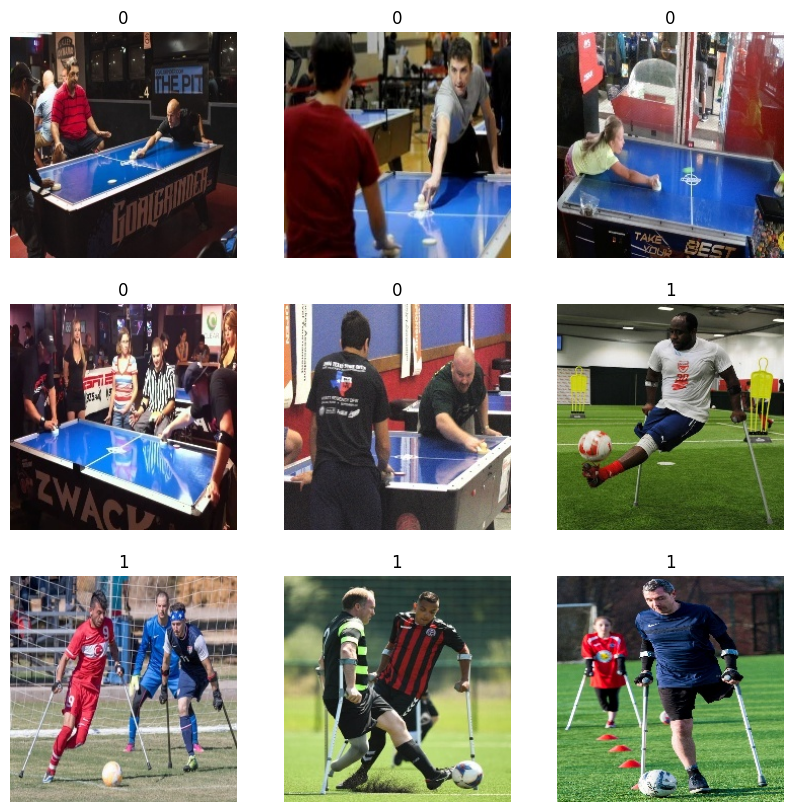

In [11]:
# Visualize validation set images
visualize_images(val_gen)

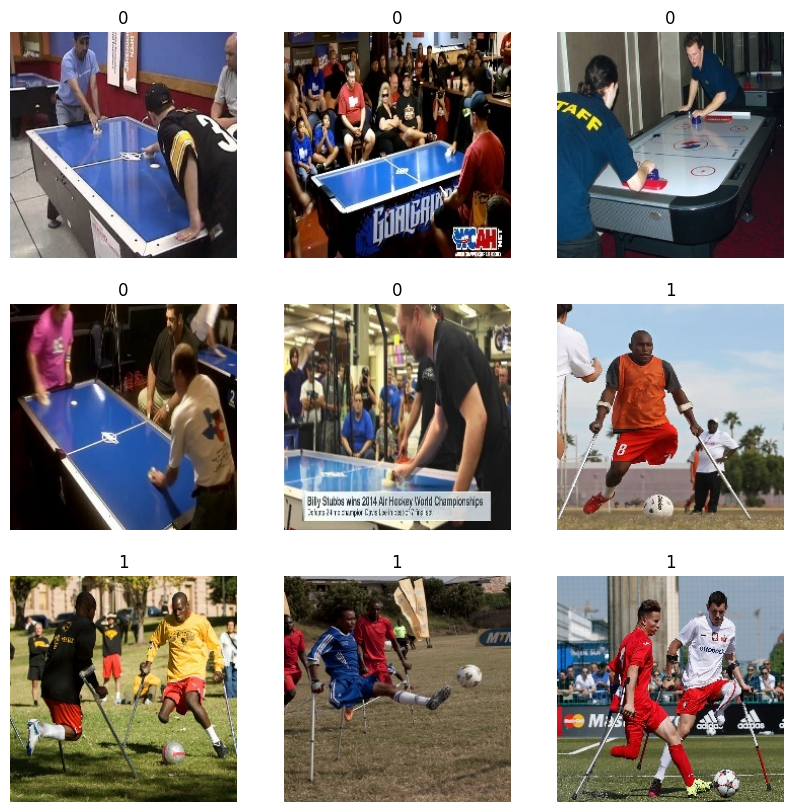

In [12]:
# Visualize test set images
visualize_images(test_gen)

# **Checking for class imbalance**

In [13]:
# Function to plot bar charts for class distribution
def plot_class_distribution_bar(train_df, val_df, test_df):
    plt.figure(figsize=(20, 5))

    # Train set
    plt.subplot(1, 3, 1)
    train_class_counts = train_df['labels'].value_counts().sort_index()
    plt.bar(train_class_counts.index, train_class_counts.values)
    plt.xticks(rotation=90)
    plt.title("Class Distribution - TRAIN")
    plt.xlabel("Classes")
    plt.ylabel("Count")

    # Validation set
    plt.subplot(1, 3, 2)
    val_class_counts = val_df['labels'].value_counts().sort_index()
    plt.bar(val_class_counts.index, val_class_counts.values)
    plt.xticks(rotation=90)
    plt.title("Class Distribution - VALIDATION")
    plt.xlabel("Classes")
    plt.ylabel("Count")

    # Test set
    plt.subplot(1, 3, 3)
    test_class_counts = test_df['labels'].value_counts().sort_index()
    plt.bar(test_class_counts.index, test_class_counts.values)
    plt.xticks(rotation=90)
    plt.title("Class Distribution - TEST")
    plt.xlabel("Classes")
    plt.ylabel("Count")

    plt.tight_layout()
    plt.show()

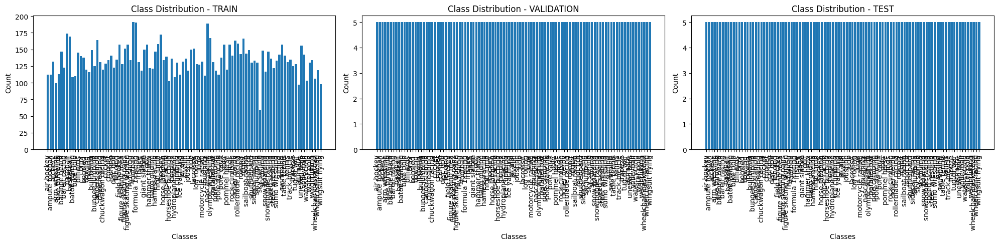

In [14]:
# Call the function to plot class distributions
plot_class_distribution_bar(train_df, val_df, test_df)

- In this case, training set has class imbalance.
- **We will use class_weights when training the model.**

# **Model creation**

In [15]:
model = Sequential()

model.add(Input(shape=(224, 224, 3)))

# Block 1
model.add(Conv2D(64, (3, 3), padding='same'))
model.add(BatchNormalization())
model.add(LeakyReLU(negative_slope=0.01))
model.add(Conv2D(64, (3, 3), padding='same'))
model.add(BatchNormalization())
model.add(LeakyReLU(negative_slope=0.01))
model.add(MaxPooling2D(pool_size=(2, 2)))

# Block 2
model.add(Conv2D(128, (3, 3), padding='same'))
model.add(BatchNormalization())
model.add(LeakyReLU(negative_slope=0.02))
model.add(Conv2D(128, (3, 3), padding='same'))
model.add(BatchNormalization())
model.add(LeakyReLU(negative_slope=0.02))
model.add(MaxPooling2D(pool_size=(2, 2)))

# Block 3
model.add(Conv2D(256, (3, 3), padding='same'))
model.add(BatchNormalization())
model.add(LeakyReLU(negative_slope=0.01))
model.add(Conv2D(256, (3, 3), padding='same'))
model.add(BatchNormalization())
model.add(LeakyReLU(negative_slope=0.01))
model.add(Conv2D(256, (3, 3), padding='same'))
model.add(BatchNormalization())
model.add(LeakyReLU(negative_slope=0.01))
model.add(MaxPooling2D(pool_size=(2, 2)))

# Block 4
model.add(Conv2D(512, (3, 3), padding='same'))
model.add(BatchNormalization())
model.add(LeakyReLU(negative_slope=0.01))
model.add(Conv2D(512, (3, 3), padding='same'))
model.add(BatchNormalization())
model.add(LeakyReLU(negative_slope=0.02))
model.add(MaxPooling2D(pool_size=(2, 2)))

# Block 5
model.add(Conv2D(512, (3, 3), padding='same'))
model.add(BatchNormalization())
model.add(LeakyReLU(negative_slope=0.01))
model.add(MaxPooling2D(pool_size=(2, 2)))

# Block 6
model.add(Conv2D(512, (3, 3), padding='same'))
model.add(BatchNormalization())
model.add(LeakyReLU(negative_slope=0.01))
model.add(MaxPooling2D(pool_size=(2, 2)))

# Combining all filtering result
model.add(Flatten())

# Fully connected layers
model.add(Dense(896, kernel_regularizer=l2(0.01)))
model.add(BatchNormalization())
model.add(LeakyReLU(negative_slope=0.01))
model.add(Dropout(0.5))

model.add(Dense(512, kernel_regularizer=l2(0.01)))
model.add(BatchNormalization())
model.add(LeakyReLU(negative_slope=0.01))
model.add(Dropout(0.3))

# Output layer for multi-class classification
model.add(Dense(100, activation='softmax'))

I0000 00:00:1727615180.905045    2205 cuda_executor.cc:1015] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
I0000 00:00:1727615181.096238    2205 cuda_executor.cc:1015] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
I0000 00:00:1727615181.096489    2205 cuda_executor.cc:1015] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
I0000 00:00:1727615181.099379    2205 cuda_executor.cc:1015] successful NUMA node read from SysFS ha

In [16]:
model.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                 │ (None, 224, 224, 64)   │         1,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 224, 224, 64)   │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu (LeakyReLU)         │ (None, 224, 224, 64)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 224, 224, 64)   │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (None, 224, 224, 64)   │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_1 (LeakyReLU)       │ (None, 224, 224, 64)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 112, 112, 64)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_2 (Conv2D)               │ (None, 112, 112, 128)  │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_2           │ (None, 112, 112, 128)  │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_2 (LeakyReLU)       │ (None, 112, 112, 128)  │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_3 (Conv2D)               │ (None, 112, 112, 128)  │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_3           │ (None, 112, 112, 128)  │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_3 (LeakyReLU)       │ (None, 112, 112, 128)  │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 56, 56, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_4 (Conv2D)               │ (None, 56, 56, 256)    │       295,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_4           │ (None, 56, 56, 256)    │         1,024 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_4 (LeakyReLU)       │ (None, 56, 56, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_5 (Conv2D)               │ (None, 56, 56, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_5           │ (None, 56, 56, 256)    │         1,024 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_5 (LeakyReLU)       │ (None, 56, 56, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_6 (Conv2D)               │ (None, 56, 56, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_6           │ (None, 56, 56, 256)    │         1,02

 Total params: 14,653,732 (55.90 MB)

 Trainable params: 14,644,516 (55.86 MB)

 Non-trainable params: 9,216 (36.00 KB)

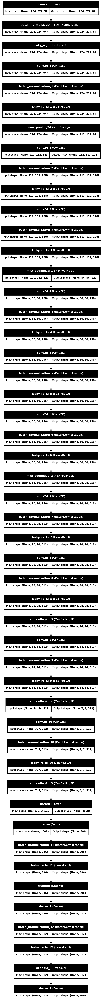

In [17]:
from tensorflow.keras.utils import plot_model
plot_model(model, to_file='model_architecture.png', show_shapes=True, show_layer_names=True, dpi=90)

---
## **Basic model architecture:**

- We took inspiration from AlexNet and VGG model architectures.
---

![](ModelArchitecture.png)

---

# **Model training**

In [18]:
model.compile(loss = 'categorical_crossentropy', optimizer=Adam(learning_rate=0.0005, clipnorm=1.0), metrics = ['accuracy'])

In [19]:
train_gen.reset()

class_weights = compute_class_weight(
    class_weight='balanced',
    classes=np.unique(train_gen.classes),
    y=train_gen.classes
)

class_weights = dict(enumerate(class_weights))

num_epochs = 300

reduce_lr = ReduceLROnPlateau(
    monitor='val_loss',
    factor=0.5,        # Factor by which the learning rate will be reduced (new_lr = lr * factor)
    patience=5,        # Number of epochs with no improvement after which learning rate will be reduced
    min_lr=1e-6,       # The minimum learning rate allowed
    verbose=1
)

checkpoint = ModelCheckpoint(
    'best_model.keras',        # Filepath where the model will be saved
    monitor='val_accuracy',
    save_best_only=True,       # Only save if model improves
    mode='max',                # Will look for the max accuracy
    verbose=1
)

early_stop = EarlyStopping(monitor='val_loss', patience=20)

In [20]:
# Resetting the generators so that those start training from the very first index
train_gen.reset()
val_gen.reset()

In [21]:
history = model.fit(train_gen,
                    steps_per_epoch=len(train_gen),
                    validation_data=(val_gen),
                    epochs=num_epochs,
                    class_weight=class_weights,
                    callbacks =[reduce_lr, checkpoint, early_stop],
                    batch_size=32,
                    verbose=1)

Epoch 1/300


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()
I0000 00:00:1727615194.122513    3704 service.cc:146] XLA service 0x7f5030015680 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1727615194.122694    3704 service.cc:154]   StreamExecutor device (0): Tesla T4, Compute Capability 7.5
2024-09-29 13:06:34.394763: I tensorflow/compiler/mlir/tensorflow/utils/dump_mlir_util.cc:268] disabling MLIR crash reproducer, set env var `MLIR_CRASH_REPRODUCER_DIRECTORY` to enable.
2024-09-29 13:06:35.852054: I external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:531] Loaded cuDNN version 8902


E0000 00:00:1727615217.175617    3704 gpu_timer.cc:183] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.
E0000 00:00:1727615217.368054    3704 gpu_timer.cc:183] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.
E0000 00:00:1727615218.612330    3704 gpu_timer.cc:183] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.
E0000 00:00:1727615218.785393    3704 gpu_timer.cc:183] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.
E0000 00:00:1727615221.101470    3704 gpu_timer.cc:183] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.
E0000

224/422 ━━━━━━━━━━━━━━━━━━━━ 1:22 415ms/step - accuracy: 0.0185 - loss: 20.1756

E0000 00:00:1727615350.490851    3701 gpu_timer.cc:183] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.
E0000 00:00:1727615350.679371    3701 gpu_timer.cc:183] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.
E0000 00:00:1727615351.489267    3701 gpu_timer.cc:183] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.
E0000 00:00:1727615351.657713    3701 gpu_timer.cc:183] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.
E0000 00:00:1727615353.267875    3701 gpu_timer.cc:183] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.
E0000

422/422 ━━━━━━━━━━━━━━━━━━━━ 0s 504ms/step - accuracy: 0.0273 - loss: 16.7673
Epoch 1: val_accuracy improved from -inf to 0.04200, saving model to best_model.keras
422/422 ━━━━━━━━━━━━━━━━━━━━ 273s 516ms/step - accuracy: 0.0274 - loss: 16.7547 - val_accuracy: 0.0420 - val_loss: 6.8294 - learning_rate: 5.0000e-04
Epoch 2/300


2024-09-29 13:10:57.670056: I tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
	 [[{{node IteratorGetNext}}]]
2024-09-29 13:10:57.670117: I tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
	 [[{{node IteratorGetNext}}]]
	 [[IteratorGetNext/_2]]
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)



Epoch 2: val_accuracy did not improve from 0.04200
422/422 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.0000e+00 - loss: 0.0000e+00 - val_accuracy: 0.0420 - val_loss: 6.8294 - learning_rate: 5.0000e-04
Epoch 3/300
422/422 ━━━━━━━━━━━━━━━━━━━━ 0s 419ms/step - accuracy: 0.0731 - loss: 6.2455
Epoch 3: val_accuracy improved from 0.04200 to 0.07800, saving model to best_model.keras
422/422 ━━━━━━━━━━━━━━━━━━━━ 183s 426ms/step - accuracy: 0.0732 - loss: 6.2446 - val_accuracy: 0.0780 - val_loss: 6.6043 - learning_rate: 5.0000e-04
Epoch 4/300


2024-09-29 13:14:02.731839: I tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
	 [[{{node IteratorGetNext}}]]
	 [[IteratorGetNext/_4]]
2024-09-29 13:14:02.731888: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10575784282402689985
2024-09-29 13:14:02.731902: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5664711274190212817



Epoch 4: val_accuracy did not improve from 0.07800
422/422 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.0000e+00 - loss: 0.0000e+00 - val_accuracy: 0.0780 - val_loss: 6.6043 - learning_rate: 5.0000e-04
Epoch 5/300
422/422 ━━━━━━━━━━━━━━━━━━━━ 0s 419ms/step - accuracy: 0.1362 - loss: 5.0905
Epoch 5: val_accuracy improved from 0.07800 to 0.12000, saving model to best_model.keras
422/422 ━━━━━━━━━━━━━━━━━━━━ 183s 426ms/step - accuracy: 0.1362 - loss: 5.0901 - val_accuracy: 0.1200 - val_loss: 5.1590 - learning_rate: 5.0000e-04
Epoch 6/300

Epoch 6: val_accuracy did not improve from 0.12000
422/422 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.0000e+00 - loss: 0.0000e+00 - val_accuracy: 0.1200 - val_loss: 5.1590 - learning_rate: 5.0000e-04
Epoch 7/300
422/422 ━━━━━━━━━━━━━━━━━━━━ 0s 419ms/step - accuracy: 0.2043 - loss: 4.5012
Epoch 7: val_accuracy improved from 0.12000 to 0.21800, saving model to best_model.keras
422/422 ━━━━━━━━━━━━━━━━━━━━ 183s 426ms/step - accuracy: 0.2043 - loss: 4

2024-09-29 13:20:12.806504: I tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
	 [[{{node IteratorGetNext}}]]
	 [[IteratorGetNext/_2]]



Epoch 8: val_accuracy did not improve from 0.21800
422/422 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.0000e+00 - loss: 0.0000e+00 - val_accuracy: 0.2180 - val_loss: 4.4268 - learning_rate: 5.0000e-04
Epoch 9/300
422/422 ━━━━━━━━━━━━━━━━━━━━ 0s 420ms/step - accuracy: 0.2570 - loss: 4.1795
Epoch 9: val_accuracy did not improve from 0.21800
422/422 ━━━━━━━━━━━━━━━━━━━━ 182s 425ms/step - accuracy: 0.2570 - loss: 4.1794 - val_accuracy: 0.1660 - val_loss: 4.7296 - learning_rate: 5.0000e-04
Epoch 10/300


2024-09-29 13:23:17.445450: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5664711274190212817



Epoch 10: val_accuracy did not improve from 0.21800
422/422 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.0000e+00 - loss: 0.0000e+00 - val_accuracy: 0.1660 - val_loss: 4.7296 - learning_rate: 5.0000e-04
Epoch 11/300
422/422 ━━━━━━━━━━━━━━━━━━━━ 0s 420ms/step - accuracy: 0.2989 - loss: 3.9570
Epoch 11: val_accuracy improved from 0.21800 to 0.31800, saving model to best_model.keras
422/422 ━━━━━━━━━━━━━━━━━━━━ 183s 427ms/step - accuracy: 0.2989 - loss: 3.9569 - val_accuracy: 0.3180 - val_loss: 3.8592 - learning_rate: 5.0000e-04
Epoch 12/300

Epoch 12: val_accuracy did not improve from 0.31800
422/422 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.0000e+00 - loss: 0.0000e+00 - val_accuracy: 0.3180 - val_loss: 3.8592 - learning_rate: 5.0000e-04
Epoch 13/300
422/422 ━━━━━━━━━━━━━━━━━━━━ 0s 420ms/step - accuracy: 0.3349 - loss: 3.7846
Epoch 13: val_accuracy did not improve from 0.31800
422/422 ━━━━━━━━━━━━━━━━━━━━ 182s 426ms/step - accuracy: 0.3349 - loss: 3.7846 - val_accuracy: 0.2560 - 

2024-09-29 13:32:31.767586: I tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
	 [[{{node IteratorGetNext}}]]
	 [[IteratorGetNext/_2]]



Epoch 16: ReduceLROnPlateau reducing learning rate to 0.0002500000118743628.

Epoch 16: val_accuracy did not improve from 0.31800
422/422 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.0000e+00 - loss: 0.0000e+00 - val_accuracy: 0.2860 - val_loss: 4.1369 - learning_rate: 5.0000e-04
Epoch 17/300
422/422 ━━━━━━━━━━━━━━━━━━━━ 0s 420ms/step - accuracy: 0.4599 - loss: 3.1457
Epoch 17: val_accuracy improved from 0.31800 to 0.58200, saving model to best_model.keras
422/422 ━━━━━━━━━━━━━━━━━━━━ 183s 428ms/step - accuracy: 0.4599 - loss: 3.1453 - val_accuracy: 0.5820 - val_loss: 2.5145 - learning_rate: 2.5000e-04
Epoch 18/300

Epoch 18: val_accuracy did not improve from 0.58200
422/422 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.0000e+00 - loss: 0.0000e+00 - val_accuracy: 0.5820 - val_loss: 2.5145 - learning_rate: 2.5000e-04
Epoch 19/300
422/422 ━━━━━━━━━━━━━━━━━━━━ 0s 420ms/step - accuracy: 0.5194 - loss: 2.6993
Epoch 19: val_accuracy did not improve from 0.58200
422/422 ━━━━━━━━━━━━━━━━━━

2024-09-29 13:44:50.857429: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5664711274190212817



Epoch 24: val_accuracy did not improve from 0.58200
422/422 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.0000e+00 - loss: 0.0000e+00 - val_accuracy: 0.5340 - val_loss: 2.5799 - learning_rate: 2.5000e-04
Epoch 25/300
422/422 ━━━━━━━━━━━━━━━━━━━━ 0s 420ms/step - accuracy: 0.5815 - loss: 2.3860
Epoch 25: val_accuracy improved from 0.58200 to 0.65000, saving model to best_model.keras
422/422 ━━━━━━━━━━━━━━━━━━━━ 183s 427ms/step - accuracy: 0.5815 - loss: 2.3861 - val_accuracy: 0.6500 - val_loss: 2.1550 - learning_rate: 2.5000e-04
Epoch 26/300

Epoch 26: val_accuracy did not improve from 0.65000
422/422 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.0000e+00 - loss: 0.0000e+00 - val_accuracy: 0.6500 - val_loss: 2.1550 - learning_rate: 2.5000e-04
Epoch 27/300
422/422 ━━━━━━━━━━━━━━━━━━━━ 0s 420ms/step - accuracy: 0.5974 - loss: 2.3240
Epoch 27: val_accuracy did not improve from 0.65000
422/422 ━━━━━━━━━━━━━━━━━━━━ 182s 425ms/step - accuracy: 0.5974 - loss: 2.3241 - val_accuracy: 0.6160 - 

2024-09-29 13:57:10.203450: I tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
	 [[{{node IteratorGetNext}}]]
	 [[IteratorGetNext/_2]]



Epoch 32: val_accuracy did not improve from 0.66000
422/422 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.0000e+00 - loss: 0.0000e+00 - val_accuracy: 0.6600 - val_loss: 2.0723 - learning_rate: 2.5000e-04
Epoch 33/300
422/422 ━━━━━━━━━━━━━━━━━━━━ 0s 420ms/step - accuracy: 0.6403 - loss: 2.2015
Epoch 33: val_accuracy improved from 0.66000 to 0.68600, saving model to best_model.keras
422/422 ━━━━━━━━━━━━━━━━━━━━ 183s 427ms/step - accuracy: 0.6402 - loss: 2.2016 - val_accuracy: 0.6860 - val_loss: 2.0496 - learning_rate: 2.5000e-04
Epoch 34/300

Epoch 34: val_accuracy did not improve from 0.68600
422/422 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.0000e+00 - loss: 0.0000e+00 - val_accuracy: 0.6860 - val_loss: 2.0496 - learning_rate: 2.5000e-04
Epoch 35/300
422/422 ━━━━━━━━━━━━━━━━━━━━ 0s 420ms/step - accuracy: 0.6640 - loss: 2.1121
Epoch 35: val_accuracy did not improve from 0.68600
422/422 ━━━━━━━━━━━━━━━━━━━━ 182s 426ms/step - accuracy: 0.6640 - loss: 2.1122 - val_accuracy: 0.6760 - 

2024-09-29 14:09:29.999211: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5664711274190212817



Epoch 40: ReduceLROnPlateau reducing learning rate to 0.0001250000059371814.

Epoch 40: val_accuracy did not improve from 0.71000
422/422 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.0000e+00 - loss: 0.0000e+00 - val_accuracy: 0.7100 - val_loss: 2.0275 - learning_rate: 2.5000e-04
Epoch 41/300
422/422 ━━━━━━━━━━━━━━━━━━━━ 0s 420ms/step - accuracy: 0.7271 - loss: 1.8630
Epoch 41: val_accuracy improved from 0.71000 to 0.74400, saving model to best_model.keras
422/422 ━━━━━━━━━━━━━━━━━━━━ 183s 428ms/step - accuracy: 0.7271 - loss: 1.8629 - val_accuracy: 0.7440 - val_loss: 1.6951 - learning_rate: 1.2500e-04
Epoch 42/300

Epoch 42: val_accuracy did not improve from 0.74400
422/422 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.0000e+00 - loss: 0.0000e+00 - val_accuracy: 0.7440 - val_loss: 1.6951 - learning_rate: 1.2500e-04
Epoch 43/300
422/422 ━━━━━━━━━━━━━━━━━━━━ 0s 421ms/step - accuracy: 0.7701 - loss: 1.5920
Epoch 43: val_accuracy improved from 0.74400 to 0.78800, saving model to best_

2024-09-29 14:15:41.251172: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10575784282402689985
2024-09-29 14:15:41.251215: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5664711274190212817



Epoch 44: val_accuracy did not improve from 0.78800
422/422 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.0000e+00 - loss: 0.0000e+00 - val_accuracy: 0.7880 - val_loss: 1.4813 - learning_rate: 1.2500e-04
Epoch 45/300
422/422 ━━━━━━━━━━━━━━━━━━━━ 0s 420ms/step - accuracy: 0.7906 - loss: 1.4411
Epoch 45: val_accuracy did not improve from 0.78800
422/422 ━━━━━━━━━━━━━━━━━━━━ 183s 426ms/step - accuracy: 0.7906 - loss: 1.4412 - val_accuracy: 0.7700 - val_loss: 1.4522 - learning_rate: 1.2500e-04
Epoch 46/300

Epoch 46: val_accuracy did not improve from 0.78800
422/422 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.0000e+00 - loss: 0.0000e+00 - val_accuracy: 0.7700 - val_loss: 1.4522 - learning_rate: 1.2500e-04
Epoch 47/300
422/422 ━━━━━━━━━━━━━━━━━━━━ 0s 420ms/step - accuracy: 0.7873 - loss: 1.4125
Epoch 47: val_accuracy did not improve from 0.78800
422/422 ━━━━━━━━━━━━━━━━━━━━ 182s 426ms/step - accuracy: 0.7873 - loss: 1.4126 - val_accuracy: 0.7340 - val_loss: 1.5693 - learning_rate: 1.25

2024-09-29 14:37:13.830010: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5664711274190212817



Epoch 58: val_accuracy did not improve from 0.78800
422/422 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.0000e+00 - loss: 0.0000e+00 - val_accuracy: 0.7760 - val_loss: 1.2529 - learning_rate: 6.2500e-05
Epoch 59/300
422/422 ━━━━━━━━━━━━━━━━━━━━ 0s 420ms/step - accuracy: 0.8770 - loss: 0.9279
Epoch 59: val_accuracy did not improve from 0.78800
422/422 ━━━━━━━━━━━━━━━━━━━━ 182s 426ms/step - accuracy: 0.8770 - loss: 0.9279 - val_accuracy: 0.7500 - val_loss: 1.2884 - learning_rate: 6.2500e-05
Epoch 60/300

Epoch 60: val_accuracy did not improve from 0.78800
422/422 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.0000e+00 - loss: 0.0000e+00 - val_accuracy: 0.7500 - val_loss: 1.2884 - learning_rate: 6.2500e-05
Epoch 61/300
422/422 ━━━━━━━━━━━━━━━━━━━━ 0s 420ms/step - accuracy: 0.8822 - loss: 0.8878
Epoch 61: val_accuracy improved from 0.78800 to 0.79600, saving model to best_model.keras
422/422 ━━━━━━━━━━━━━━━━━━━━ 183s 428ms/step - accuracy: 0.8822 - loss: 0.8879 - val_accuracy: 0.7960 - 

2024-09-29 14:43:23.980737: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5664711274190212817



Epoch 62: val_accuracy did not improve from 0.79600
422/422 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.0000e+00 - loss: 0.0000e+00 - val_accuracy: 0.7960 - val_loss: 1.1372 - learning_rate: 6.2500e-05
Epoch 63/300
422/422 ━━━━━━━━━━━━━━━━━━━━ 0s 421ms/step - accuracy: 0.8814 - loss: 0.8760
Epoch 63: val_accuracy did not improve from 0.79600
422/422 ━━━━━━━━━━━━━━━━━━━━ 183s 427ms/step - accuracy: 0.8814 - loss: 0.8760 - val_accuracy: 0.7760 - val_loss: 1.1922 - learning_rate: 6.2500e-05
Epoch 64/300


2024-09-29 14:46:29.047668: I tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
	 [[{{node IteratorGetNext}}]]
	 [[IteratorGetNext/_2]]



Epoch 64: val_accuracy did not improve from 0.79600
422/422 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.0000e+00 - loss: 0.0000e+00 - val_accuracy: 0.7760 - val_loss: 1.1922 - learning_rate: 6.2500e-05
Epoch 65/300
422/422 ━━━━━━━━━━━━━━━━━━━━ 0s 421ms/step - accuracy: 0.8847 - loss: 0.8433
Epoch 65: val_accuracy did not improve from 0.79600
422/422 ━━━━━━━━━━━━━━━━━━━━ 182s 427ms/step - accuracy: 0.8847 - loss: 0.8434 - val_accuracy: 0.7520 - val_loss: 1.2876 - learning_rate: 6.2500e-05
Epoch 66/300

Epoch 66: ReduceLROnPlateau reducing learning rate to 3.125000148429535e-05.

Epoch 66: val_accuracy did not improve from 0.79600
422/422 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.0000e+00 - loss: 0.0000e+00 - val_accuracy: 0.7520 - val_loss: 1.2876 - learning_rate: 6.2500e-05
Epoch 67/300
422/422 ━━━━━━━━━━━━━━━━━━━━ 0s 421ms/step - accuracy: 0.9045 - loss: 0.7797
Epoch 67: val_accuracy did not improve from 0.79600
422/422 ━━━━━━━━━━━━━━━━━━━━ 182s 427ms/step - accuracy: 0.9045 

2024-09-29 15:32:47.932217: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5664711274190212817



Epoch 94: val_accuracy did not improve from 0.82600
422/422 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.0000e+00 - loss: 0.0000e+00 - val_accuracy: 0.8140 - val_loss: 0.9440 - learning_rate: 1.5625e-05
Epoch 95/300
422/422 ━━━━━━━━━━━━━━━━━━━━ 0s 422ms/step - accuracy: 0.9612 - loss: 0.4333
Epoch 95: val_accuracy did not improve from 0.82600
422/422 ━━━━━━━━━━━━━━━━━━━━ 183s 428ms/step - accuracy: 0.9612 - loss: 0.4333 - val_accuracy: 0.8140 - val_loss: 0.9638 - learning_rate: 1.5625e-05
Epoch 96/300

Epoch 96: val_accuracy did not improve from 0.82600
422/422 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.0000e+00 - loss: 0.0000e+00 - val_accuracy: 0.8140 - val_loss: 0.9638 - learning_rate: 1.5625e-05
Epoch 97/300
422/422 ━━━━━━━━━━━━━━━━━━━━ 0s 421ms/step - accuracy: 0.9624 - loss: 0.4249
Epoch 97: val_accuracy did not improve from 0.82600
422/422 ━━━━━━━━━━━━━━━━━━━━ 183s 427ms/step - accuracy: 0.9624 - loss: 0.4249 - val_accuracy: 0.8040 - val_loss: 0.9510 - learning_rate: 1.56

2024-09-29 15:42:03.547472: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10575784282402689985
2024-09-29 15:42:03.547506: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5664711274190212817



Epoch 100: val_accuracy did not improve from 0.82600
422/422 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.0000e+00 - loss: 0.0000e+00 - val_accuracy: 0.8080 - val_loss: 0.9197 - learning_rate: 7.8125e-06
Epoch 101/300
422/422 ━━━━━━━━━━━━━━━━━━━━ 0s 422ms/step - accuracy: 0.9689 - loss: 0.3998
Epoch 101: val_accuracy did not improve from 0.82600
422/422 ━━━━━━━━━━━━━━━━━━━━ 183s 428ms/step - accuracy: 0.9689 - loss: 0.3998 - val_accuracy: 0.8240 - val_loss: 0.9215 - learning_rate: 7.8125e-06
Epoch 102/300

Epoch 102: val_accuracy did not improve from 0.82600
422/422 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.0000e+00 - loss: 0.0000e+00 - val_accuracy: 0.8240 - val_loss: 0.9215 - learning_rate: 7.8125e-06
Epoch 103/300
422/422 ━━━━━━━━━━━━━━━━━━━━ 0s 422ms/step - accuracy: 0.9718 - loss: 0.3856
Epoch 103: val_accuracy did not improve from 0.82600
422/422 ━━━━━━━━━━━━━━━━━━━━ 183s 428ms/step - accuracy: 0.9718 - loss: 0.3856 - val_accuracy: 0.8220 - val_loss: 0.9001 - learning_rat

2024-09-29 16:06:47.786296: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10575784282402689985
2024-09-29 16:06:47.786331: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 9318428379793042303
2024-09-29 16:06:47.786344: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5664711274190212817



Epoch 116: ReduceLROnPlateau reducing learning rate to 1.9531250927684596e-06.

Epoch 116: val_accuracy did not improve from 0.82800
422/422 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.0000e+00 - loss: 0.0000e+00 - val_accuracy: 0.8180 - val_loss: 0.9013 - learning_rate: 3.9063e-06
Epoch 117/300
422/422 ━━━━━━━━━━━━━━━━━━━━ 0s 422ms/step - accuracy: 0.9750 - loss: 0.3454
Epoch 117: val_accuracy did not improve from 0.82800
422/422 ━━━━━━━━━━━━━━━━━━━━ 183s 428ms/step - accuracy: 0.9750 - loss: 0.3454 - val_accuracy: 0.8160 - val_loss: 0.9011 - learning_rate: 1.9531e-06
Epoch 118/300


2024-09-29 16:09:53.340168: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5664711274190212817



Epoch 118: val_accuracy did not improve from 0.82800
422/422 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.0000e+00 - loss: 0.0000e+00 - val_accuracy: 0.8160 - val_loss: 0.9011 - learning_rate: 1.9531e-06
Epoch 119/300
422/422 ━━━━━━━━━━━━━━━━━━━━ 0s 422ms/step - accuracy: 0.9783 - loss: 0.3367
Epoch 119: val_accuracy did not improve from 0.82800
422/422 ━━━━━━━━━━━━━━━━━━━━ 183s 428ms/step - accuracy: 0.9783 - loss: 0.3367 - val_accuracy: 0.8140 - val_loss: 0.8979 - learning_rate: 1.9531e-06
Epoch 120/300


2024-09-29 16:12:58.898818: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5664711274190212817



Epoch 120: val_accuracy did not improve from 0.82800
422/422 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.0000e+00 - loss: 0.0000e+00 - val_accuracy: 0.8140 - val_loss: 0.8979 - learning_rate: 1.9531e-06
Epoch 121/300
422/422 ━━━━━━━━━━━━━━━━━━━━ 0s 422ms/step - accuracy: 0.9765 - loss: 0.3326
Epoch 121: val_accuracy did not improve from 0.82800
422/422 ━━━━━━━━━━━━━━━━━━━━ 183s 428ms/step - accuracy: 0.9765 - loss: 0.3326 - val_accuracy: 0.8120 - val_loss: 0.8990 - learning_rate: 1.9531e-06
Epoch 122/300

Epoch 122: val_accuracy did not improve from 0.82800
422/422 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.0000e+00 - loss: 0.0000e+00 - val_accuracy: 0.8120 - val_loss: 0.8990 - learning_rate: 1.9531e-06
Epoch 123/300
422/422 ━━━━━━━━━━━━━━━━━━━━ 0s 422ms/step - accuracy: 0.9776 - loss: 0.3311
Epoch 123: val_accuracy did not improve from 0.82800
422/422 ━━━━━━━━━━━━━━━━━━━━ 183s 428ms/step - accuracy: 0.9776 - loss: 0.3311 - val_accuracy: 0.8120 - val_loss: 0.8963 - learning_rat

2024-09-29 16:19:09.596909: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5664711274190212817



Epoch 124: val_accuracy did not improve from 0.82800
422/422 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.0000e+00 - loss: 0.0000e+00 - val_accuracy: 0.8120 - val_loss: 0.8963 - learning_rate: 1.9531e-06
Epoch 125/300
422/422 ━━━━━━━━━━━━━━━━━━━━ 0s 422ms/step - accuracy: 0.9758 - loss: 0.3332
Epoch 125: val_accuracy did not improve from 0.82800
422/422 ━━━━━━━━━━━━━━━━━━━━ 183s 428ms/step - accuracy: 0.9758 - loss: 0.3332 - val_accuracy: 0.8140 - val_loss: 0.8950 - learning_rate: 1.9531e-06
Epoch 126/300

Epoch 126: val_accuracy did not improve from 0.82800
422/422 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.0000e+00 - loss: 0.0000e+00 - val_accuracy: 0.8140 - val_loss: 0.8950 - learning_rate: 1.9531e-06
Epoch 127/300
422/422 ━━━━━━━━━━━━━━━━━━━━ 0s 422ms/step - accuracy: 0.9795 - loss: 0.3330
Epoch 127: val_accuracy did not improve from 0.82800
422/422 ━━━━━━━━━━━━━━━━━━━━ 183s 428ms/step - accuracy: 0.9795 - loss: 0.3330 - val_accuracy: 0.8100 - val_loss: 0.8892 - learning_rat

2024-09-29 16:25:20.299518: I tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
	 [[{{node IteratorGetNext}}]]
	 [[IteratorGetNext/_2]]



Epoch 128: val_accuracy did not improve from 0.82800
422/422 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.0000e+00 - loss: 0.0000e+00 - val_accuracy: 0.8100 - val_loss: 0.8892 - learning_rate: 1.9531e-06
Epoch 129/300
422/422 ━━━━━━━━━━━━━━━━━━━━ 0s 422ms/step - accuracy: 0.9809 - loss: 0.3222
Epoch 129: val_accuracy did not improve from 0.82800
422/422 ━━━━━━━━━━━━━━━━━━━━ 183s 428ms/step - accuracy: 0.9809 - loss: 0.3222 - val_accuracy: 0.8120 - val_loss: 0.8916 - learning_rate: 1.9531e-06
Epoch 130/300

Epoch 130: val_accuracy did not improve from 0.82800
422/422 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.0000e+00 - loss: 0.0000e+00 - val_accuracy: 0.8120 - val_loss: 0.8916 - learning_rate: 1.9531e-06
Epoch 131/300
422/422 ━━━━━━━━━━━━━━━━━━━━ 0s 422ms/step - accuracy: 0.9813 - loss: 0.3201
Epoch 131: val_accuracy did not improve from 0.82800
422/422 ━━━━━━━━━━━━━━━━━━━━ 183s 428ms/step - accuracy: 0.9813 - loss: 0.3201 - val_accuracy: 0.8120 - val_loss: 0.8938 - learning_rat

2024-09-29 16:53:08.988741: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5664711274190212817



Epoch 146: val_accuracy did not improve from 0.82800
422/422 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.0000e+00 - loss: 0.0000e+00 - val_accuracy: 0.8120 - val_loss: 0.8852 - learning_rate: 1.0000e-06
Epoch 147/300
422/422 ━━━━━━━━━━━━━━━━━━━━ 0s 422ms/step - accuracy: 0.9811 - loss: 0.3101
Epoch 147: val_accuracy did not improve from 0.82800
422/422 ━━━━━━━━━━━━━━━━━━━━ 183s 428ms/step - accuracy: 0.9811 - loss: 0.3101 - val_accuracy: 0.8100 - val_loss: 0.8860 - learning_rate: 1.0000e-06
Epoch 148/300

Epoch 148: val_accuracy did not improve from 0.82800
422/422 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.0000e+00 - loss: 0.0000e+00 - val_accuracy: 0.8100 - val_loss: 0.8860 - learning_rate: 1.0000e-06
Epoch 149/300
422/422 ━━━━━━━━━━━━━━━━━━━━ 0s 423ms/step - accuracy: 0.9795 - loss: 0.3135
Epoch 149: val_accuracy did not improve from 0.82800
422/422 ━━━━━━━━━━━━━━━━━━━━ 183s 428ms/step - accuracy: 0.9795 - loss: 0.3135 - val_accuracy: 0.8080 - val_loss: 0.8841 - learning_rat

2024-09-29 17:24:04.294361: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5664711274190212817



Epoch 166: val_accuracy did not improve from 0.82800
422/422 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.0000e+00 - loss: 0.0000e+00 - val_accuracy: 0.8100 - val_loss: 0.8819 - learning_rate: 1.0000e-06
Epoch 167/300
422/422 ━━━━━━━━━━━━━━━━━━━━ 0s 422ms/step - accuracy: 0.9803 - loss: 0.3049
Epoch 167: val_accuracy did not improve from 0.82800
422/422 ━━━━━━━━━━━━━━━━━━━━ 183s 428ms/step - accuracy: 0.9803 - loss: 0.3049 - val_accuracy: 0.8120 - val_loss: 0.8855 - learning_rate: 1.0000e-06
Epoch 168/300

Epoch 168: val_accuracy did not improve from 0.82800
422/422 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.0000e+00 - loss: 0.0000e+00 - val_accuracy: 0.8120 - val_loss: 0.8855 - learning_rate: 1.0000e-06
Epoch 169/300
422/422 ━━━━━━━━━━━━━━━━━━━━ 0s 422ms/step - accuracy: 0.9797 - loss: 0.3028
Epoch 169: val_accuracy did not improve from 0.82800
422/422 ━━━━━━━━━━━━━━━━━━━━ 183s 428ms/step - accuracy: 0.9797 - loss: 0.3028 - val_accuracy: 0.8120 - val_loss: 0.8765 - learning_rat

2024-09-29 17:42:37.799514: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5664711274190212817



Epoch 178: val_accuracy did not improve from 0.82800
422/422 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.0000e+00 - loss: 0.0000e+00 - val_accuracy: 0.8120 - val_loss: 0.8814 - learning_rate: 1.0000e-06
Epoch 179/300
422/422 ━━━━━━━━━━━━━━━━━━━━ 0s 422ms/step - accuracy: 0.9815 - loss: 0.2982
Epoch 179: val_accuracy did not improve from 0.82800
422/422 ━━━━━━━━━━━━━━━━━━━━ 183s 428ms/step - accuracy: 0.9815 - loss: 0.2982 - val_accuracy: 0.8120 - val_loss: 0.8808 - learning_rate: 1.0000e-06
Epoch 180/300

Epoch 180: val_accuracy did not improve from 0.82800
422/422 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.0000e+00 - loss: 0.0000e+00 - val_accuracy: 0.8120 - val_loss: 0.8808 - learning_rate: 1.0000e-06
Epoch 181/300
422/422 ━━━━━━━━━━━━━━━━━━━━ 0s 422ms/step - accuracy: 0.9841 - loss: 0.2897
Epoch 181: val_accuracy did not improve from 0.82800
422/422 ━━━━━━━━━━━━━━━━━━━━ 183s 428ms/step - accuracy: 0.9841 - loss: 0.2897 - val_accuracy: 0.8140 - val_loss: 0.8740 - learning_rat

2024-09-29 17:55:00.283842: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5664711274190212817



Epoch 186: val_accuracy did not improve from 0.82800
422/422 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.0000e+00 - loss: 0.0000e+00 - val_accuracy: 0.8180 - val_loss: 0.8791 - learning_rate: 1.0000e-06
Epoch 187/300
422/422 ━━━━━━━━━━━━━━━━━━━━ 0s 423ms/step - accuracy: 0.9835 - loss: 0.2895
Epoch 187: val_accuracy did not improve from 0.82800
422/422 ━━━━━━━━━━━━━━━━━━━━ 183s 428ms/step - accuracy: 0.9835 - loss: 0.2895 - val_accuracy: 0.8180 - val_loss: 0.8762 - learning_rate: 1.0000e-06
Epoch 188/300

Epoch 188: val_accuracy did not improve from 0.82800
422/422 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.0000e+00 - loss: 0.0000e+00 - val_accuracy: 0.8180 - val_loss: 0.8762 - learning_rate: 1.0000e-06
Epoch 189/300
422/422 ━━━━━━━━━━━━━━━━━━━━ 0s 423ms/step - accuracy: 0.9877 - loss: 0.2821
Epoch 189: val_accuracy did not improve from 0.82800
422/422 ━━━━━━━━━━━━━━━━━━━━ 183s 428ms/step - accuracy: 0.9877 - loss: 0.2821 - val_accuracy: 0.8180 - val_loss: 0.8717 - learning_rat

2024-09-29 18:16:39.682207: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5664711274190212817



Epoch 200: val_accuracy did not improve from 0.82800
422/422 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.0000e+00 - loss: 0.0000e+00 - val_accuracy: 0.8160 - val_loss: 0.8671 - learning_rate: 1.0000e-06
Epoch 201/300
422/422 ━━━━━━━━━━━━━━━━━━━━ 0s 422ms/step - accuracy: 0.9856 - loss: 0.2805
Epoch 201: val_accuracy did not improve from 0.82800
422/422 ━━━━━━━━━━━━━━━━━━━━ 183s 428ms/step - accuracy: 0.9856 - loss: 0.2805 - val_accuracy: 0.8200 - val_loss: 0.8719 - learning_rate: 1.0000e-06
Epoch 202/300


2024-09-29 18:19:45.331642: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5664711274190212817



Epoch 202: val_accuracy did not improve from 0.82800
422/422 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.0000e+00 - loss: 0.0000e+00 - val_accuracy: 0.8200 - val_loss: 0.8719 - learning_rate: 1.0000e-06
Epoch 203/300
422/422 ━━━━━━━━━━━━━━━━━━━━ 0s 422ms/step - accuracy: 0.9858 - loss: 0.2791
Epoch 203: val_accuracy did not improve from 0.82800
422/422 ━━━━━━━━━━━━━━━━━━━━ 183s 428ms/step - accuracy: 0.9858 - loss: 0.2791 - val_accuracy: 0.8180 - val_loss: 0.8680 - learning_rate: 1.0000e-06
Epoch 204/300

Epoch 204: val_accuracy did not improve from 0.82800
422/422 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.0000e+00 - loss: 0.0000e+00 - val_accuracy: 0.8180 - val_loss: 0.8680 - learning_rate: 1.0000e-06
Epoch 205/300
422/422 ━━━━━━━━━━━━━━━━━━━━ 0s 422ms/step - accuracy: 0.9830 - loss: 0.2816
Epoch 205: val_accuracy did not improve from 0.82800
422/422 ━━━━━━━━━━━━━━━━━━━━ 183s 428ms/step - accuracy: 0.9830 - loss: 0.2816 - val_accuracy: 0.8200 - val_loss: 0.8690 - learning_rat

2024-09-29 18:32:07.693515: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5664711274190212817



Epoch 210: val_accuracy did not improve from 0.82800
422/422 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.0000e+00 - loss: 0.0000e+00 - val_accuracy: 0.8260 - val_loss: 0.8662 - learning_rate: 1.0000e-06
Epoch 211/300
422/422 ━━━━━━━━━━━━━━━━━━━━ 0s 422ms/step - accuracy: 0.9848 - loss: 0.2795
Epoch 211: val_accuracy did not improve from 0.82800
422/422 ━━━━━━━━━━━━━━━━━━━━ 183s 428ms/step - accuracy: 0.9848 - loss: 0.2795 - val_accuracy: 0.8220 - val_loss: 0.8676 - learning_rate: 1.0000e-06
Epoch 212/300

Epoch 212: val_accuracy did not improve from 0.82800
422/422 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.0000e+00 - loss: 0.0000e+00 - val_accuracy: 0.8220 - val_loss: 0.8676 - learning_rate: 1.0000e-06
Epoch 213/300
422/422 ━━━━━━━━━━━━━━━━━━━━ 0s 422ms/step - accuracy: 0.9863 - loss: 0.2693
Epoch 213: val_accuracy did not improve from 0.82800
422/422 ━━━━━━━━━━━━━━━━━━━━ 183s 428ms/step - accuracy: 0.9863 - loss: 0.2694 - val_accuracy: 0.8200 - val_loss: 0.8709 - learning_rat

2024-09-29 18:59:58.737748: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5664711274190212817



Epoch 228: val_accuracy did not improve from 0.82800
422/422 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.0000e+00 - loss: 0.0000e+00 - val_accuracy: 0.8200 - val_loss: 0.8636 - learning_rate: 1.0000e-06
Epoch 229/300
422/422 ━━━━━━━━━━━━━━━━━━━━ 0s 422ms/step - accuracy: 0.9836 - loss: 0.2707
Epoch 229: val_accuracy did not improve from 0.82800
422/422 ━━━━━━━━━━━━━━━━━━━━ 183s 428ms/step - accuracy: 0.9836 - loss: 0.2707 - val_accuracy: 0.8160 - val_loss: 0.8635 - learning_rate: 1.0000e-06
Epoch 230/300

Epoch 230: val_accuracy did not improve from 0.82800
422/422 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.0000e+00 - loss: 0.0000e+00 - val_accuracy: 0.8160 - val_loss: 0.8635 - learning_rate: 1.0000e-06
Epoch 231/300
422/422 ━━━━━━━━━━━━━━━━━━━━ 0s 422ms/step - accuracy: 0.9843 - loss: 0.2707
Epoch 231: val_accuracy did not improve from 0.82800
422/422 ━━━━━━━━━━━━━━━━━━━━ 183s 428ms/step - accuracy: 0.9843 - loss: 0.2707 - val_accuracy: 0.8200 - val_loss: 0.8583 - learning_rat

2024-09-29 19:09:15.354102: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5664711274190212817



Epoch 234: val_accuracy did not improve from 0.82800
422/422 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.0000e+00 - loss: 0.0000e+00 - val_accuracy: 0.8200 - val_loss: 0.8651 - learning_rate: 1.0000e-06
Epoch 235/300
422/422 ━━━━━━━━━━━━━━━━━━━━ 0s 422ms/step - accuracy: 0.9857 - loss: 0.2662
Epoch 235: val_accuracy did not improve from 0.82800
422/422 ━━━━━━━━━━━━━━━━━━━━ 183s 428ms/step - accuracy: 0.9857 - loss: 0.2662 - val_accuracy: 0.8140 - val_loss: 0.8658 - learning_rate: 1.0000e-06
Epoch 236/300

Epoch 236: val_accuracy did not improve from 0.82800
422/422 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.0000e+00 - loss: 0.0000e+00 - val_accuracy: 0.8140 - val_loss: 0.8658 - learning_rate: 1.0000e-06
Epoch 237/300
422/422 ━━━━━━━━━━━━━━━━━━━━ 0s 422ms/step - accuracy: 0.9877 - loss: 0.2624
Epoch 237: val_accuracy did not improve from 0.82800
422/422 ━━━━━━━━━━━━━━━━━━━━ 183s 428ms/step - accuracy: 0.9877 - loss: 0.2624 - val_accuracy: 0.8140 - val_loss: 0.8702 - learning_rat

2024-09-29 19:24:43.637439: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10575784282402689985
2024-09-29 19:24:43.637483: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5664711274190212817



Epoch 244: val_accuracy did not improve from 0.82800
422/422 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.0000e+00 - loss: 0.0000e+00 - val_accuracy: 0.8160 - val_loss: 0.8642 - learning_rate: 1.0000e-06
Epoch 245/300
422/422 ━━━━━━━━━━━━━━━━━━━━ 0s 423ms/step - accuracy: 0.9879 - loss: 0.2593
Epoch 245: val_accuracy did not improve from 0.82800
422/422 ━━━━━━━━━━━━━━━━━━━━ 183s 428ms/step - accuracy: 0.9879 - loss: 0.2593 - val_accuracy: 0.8160 - val_loss: 0.8674 - learning_rate: 1.0000e-06
Epoch 246/300

Epoch 246: val_accuracy did not improve from 0.82800
422/422 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.0000e+00 - loss: 0.0000e+00 - val_accuracy: 0.8160 - val_loss: 0.8674 - learning_rate: 1.0000e-06
Epoch 247/300
422/422 ━━━━━━━━━━━━━━━━━━━━ 0s 423ms/step - accuracy: 0.9895 - loss: 0.2577
Epoch 247: val_accuracy did not improve from 0.82800
422/422 ━━━━━━━━━━━━━━━━━━━━ 183s 428ms/step - accuracy: 0.9895 - loss: 0.2577 - val_accuracy: 0.8140 - val_loss: 0.8648 - learning_rat

2024-09-29 19:34:00.779558: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5664711274190212817



Epoch 250: val_accuracy did not improve from 0.82800
422/422 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.0000e+00 - loss: 0.0000e+00 - val_accuracy: 0.8200 - val_loss: 0.8537 - learning_rate: 1.0000e-06
Epoch 251/300
422/422 ━━━━━━━━━━━━━━━━━━━━ 0s 423ms/step - accuracy: 0.9859 - loss: 0.2576
Epoch 251: val_accuracy did not improve from 0.82800
422/422 ━━━━━━━━━━━━━━━━━━━━ 183s 429ms/step - accuracy: 0.9859 - loss: 0.2576 - val_accuracy: 0.8180 - val_loss: 0.8579 - learning_rate: 1.0000e-06
Epoch 252/300

Epoch 252: val_accuracy did not improve from 0.82800
422/422 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.0000e+00 - loss: 0.0000e+00 - val_accuracy: 0.8180 - val_loss: 0.8579 - learning_rate: 1.0000e-06
Epoch 253/300
422/422 ━━━━━━━━━━━━━━━━━━━━ 0s 423ms/step - accuracy: 0.9871 - loss: 0.2586
Epoch 253: val_accuracy did not improve from 0.82800
422/422 ━━━━━━━━━━━━━━━━━━━━ 183s 428ms/step - accuracy: 0.9871 - loss: 0.2586 - val_accuracy: 0.8200 - val_loss: 0.8562 - learning_rat

2024-09-29 19:43:17.855238: I tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
	 [[{{node IteratorGetNext}}]]
	 [[IteratorGetNext/_2]]



Epoch 256: val_accuracy did not improve from 0.82800
422/422 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.0000e+00 - loss: 0.0000e+00 - val_accuracy: 0.8180 - val_loss: 0.8623 - learning_rate: 1.0000e-06
Epoch 257/300
422/422 ━━━━━━━━━━━━━━━━━━━━ 0s 422ms/step - accuracy: 0.9854 - loss: 0.2584
Epoch 257: val_accuracy did not improve from 0.82800
422/422 ━━━━━━━━━━━━━━━━━━━━ 183s 428ms/step - accuracy: 0.9854 - loss: 0.2584 - val_accuracy: 0.8180 - val_loss: 0.8612 - learning_rate: 1.0000e-06
Epoch 258/300

Epoch 258: val_accuracy did not improve from 0.82800
422/422 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.0000e+00 - loss: 0.0000e+00 - val_accuracy: 0.8180 - val_loss: 0.8612 - learning_rate: 1.0000e-06
Epoch 259/300
422/422 ━━━━━━━━━━━━━━━━━━━━ 0s 422ms/step - accuracy: 0.9856 - loss: 0.2554
Epoch 259: val_accuracy did not improve from 0.82800
422/422 ━━━━━━━━━━━━━━━━━━━━ 183s 428ms/step - accuracy: 0.9856 - loss: 0.2554 - val_accuracy: 0.8160 - val_loss: 0.8566 - learning_rat

2024-09-29 19:58:45.725407: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10575784282402689985
2024-09-29 19:58:45.725447: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5664711274190212817



Epoch 266: val_accuracy did not improve from 0.82800
422/422 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.0000e+00 - loss: 0.0000e+00 - val_accuracy: 0.8160 - val_loss: 0.8565 - learning_rate: 1.0000e-06
Epoch 267/300
422/422 ━━━━━━━━━━━━━━━━━━━━ 0s 423ms/step - accuracy: 0.9889 - loss: 0.2486
Epoch 267: val_accuracy did not improve from 0.82800
422/422 ━━━━━━━━━━━━━━━━━━━━ 183s 428ms/step - accuracy: 0.9889 - loss: 0.2486 - val_accuracy: 0.8180 - val_loss: 0.8477 - learning_rate: 1.0000e-06
Epoch 268/300

Epoch 268: val_accuracy did not improve from 0.82800
422/422 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.0000e+00 - loss: 0.0000e+00 - val_accuracy: 0.8180 - val_loss: 0.8477 - learning_rate: 1.0000e-06
Epoch 269/300
422/422 ━━━━━━━━━━━━━━━━━━━━ 0s 422ms/step - accuracy: 0.9868 - loss: 0.2519
Epoch 269: val_accuracy did not improve from 0.82800
422/422 ━━━━━━━━━━━━━━━━━━━━ 183s 428ms/step - accuracy: 0.9868 - loss: 0.2519 - val_accuracy: 0.8200 - val_loss: 0.8499 - learning_rat

2024-09-29 20:29:41.684566: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5664711274190212817



Epoch 286: val_accuracy did not improve from 0.82800
422/422 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.0000e+00 - loss: 0.0000e+00 - val_accuracy: 0.8200 - val_loss: 0.8502 - learning_rate: 1.0000e-06
Epoch 287/300
422/422 ━━━━━━━━━━━━━━━━━━━━ 0s 422ms/step - accuracy: 0.9876 - loss: 0.2443
Epoch 287: val_accuracy did not improve from 0.82800
422/422 ━━━━━━━━━━━━━━━━━━━━ 183s 428ms/step - accuracy: 0.9876 - loss: 0.2443 - val_accuracy: 0.8200 - val_loss: 0.8508 - learning_rate: 1.0000e-06


# **Model performance**

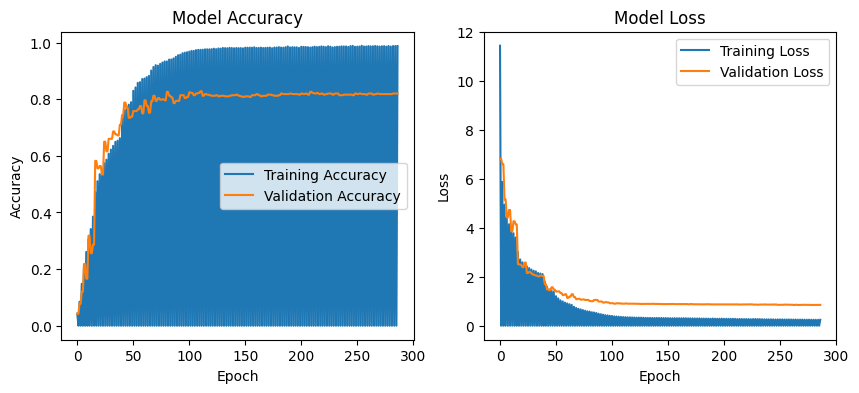

In [30]:
# Plotting training history
plt.rcParams['figure.figsize'] = (10, 4)

# Plotting accuracy
plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.title('Model Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()

# Plotting loss
plt.subplot(1, 2, 2)
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Model Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()

In [33]:
# Loading the best model trained
model = load_model('best_model.keras')

In [34]:
# Accuracy of training data
train_gen.reset()
train_loss, train_accuracy = model.evaluate(train_gen, verbose=1)
print(f'Training Loss: {(train_loss):.2f}, Training Accuracy: {(train_accuracy * 100):.2f}%')

 47/422 ━━━━━━━━━━━━━━━━━━━━ 1:54 304ms/step - accuracy: 1.0000 - loss: 0.2580

422/422 ━━━━━━━━━━━━━━━━━━━━ 131s 306ms/step - accuracy: 0.9996 - loss: 0.2588
Training Loss: 0.26, Training Accuracy: 99.93%


In [35]:
# Accuracy of validation data
val_loss, val_accuracy = model.evaluate(val_gen, verbose=1)
print(f'Validation Loss: {(val_loss):.2f}, Validation Accuracy: {(val_accuracy * 100):.2f}%')

 1/16 ━━━━━━━━━━━━━━━━━━━━ 3s 202ms/step - accuracy: 0.9375 - loss: 0.5716

16/16 ━━━━━━━━━━━━━━━━━━━━ 2s 146ms/step - accuracy: 0.8436 - loss: 0.8580
Validation Loss: 0.90, Validation Accuracy: 82.80%


In [36]:
# Evaluate the model on the test data
test_loss, test_accuracy = model.evaluate(test_gen, verbose=1)
print(f'Test Loss: {(test_loss):.2f}, Test Accuracy: {(test_accuracy * 100):.2f}%')

 1/16 ━━━━━━━━━━━━━━━━━━━━ 3s 207ms/step - accuracy: 0.9375 - loss: 0.5793

16/16 ━━━━━━━━━━━━━━━━━━━━ 2s 146ms/step - accuracy: 0.8455 - loss: 0.7801
Test Loss: 0.79, Test Accuracy: 84.20%


---
## **Model accuracy:**
---

Upon training multiple times, the accuracy of the model on the **test set** ranges from **84.20%** to **86.20%**.

---

16/16 ━━━━━━━━━━━━━━━━━━━━ 3s 178ms/step
                       precision    recall  f1-score   support

           air hockey       0.83      1.00      0.91         5
      ampute football       1.00      1.00      1.00         5
              archery       0.80      0.80      0.80         5
        arm wrestling       1.00      1.00      1.00         5
         axe throwing       1.00      0.80      0.89         5
         balance beam       0.83      1.00      0.91         5
        barell racing       1.00      1.00      1.00         5
             baseball       1.00      1.00      1.00         5
           basketball       0.67      0.80      0.73         5
       baton twirling       0.40      0.40      0.40         5
            bike polo       1.00      0.80      0.89         5
            billiards       1.00      1.00      1.00         5
                  bmx       1.00      0.40      0.57         5
              bobsled       0.80      0.80      0.80         5
             

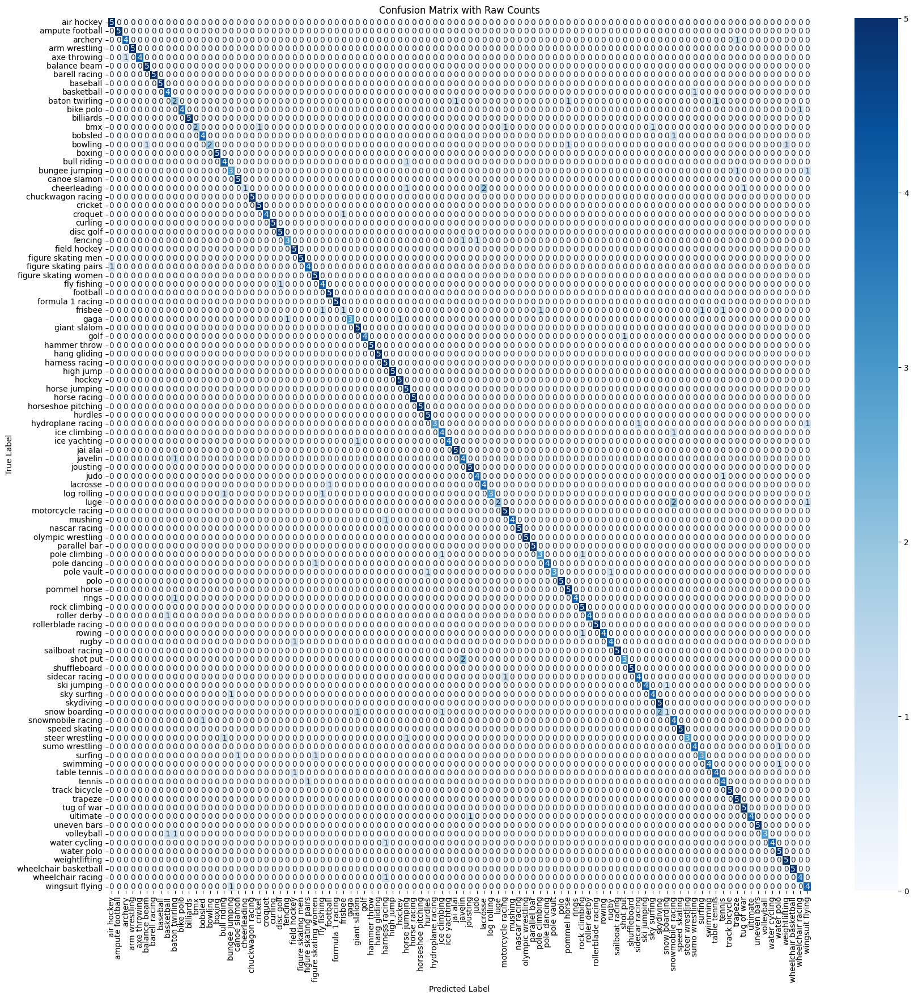

In [37]:
# Predict the labels for test data
test_gen.reset()
y_pred = np.argmax(model.predict(test_gen), axis=-1)
y_true = np.array(test_gen.classes)

# Classification report
class_names = list(test_gen.class_indices.keys())
print(classification_report(y_true, y_pred, target_names=class_names))

# Plot the confusion matrix
cm = confusion_matrix(y_true, y_pred)
plt.figure(figsize=(20, 20))
sns.heatmap(cm, annot=True, cmap="Blues", fmt="d", xticklabels=class_names, yticklabels=class_names)
plt.title("Confusion Matrix with Raw Counts")
plt.ylabel("True Label")
plt.xlabel("Predicted Label")
plt.show()


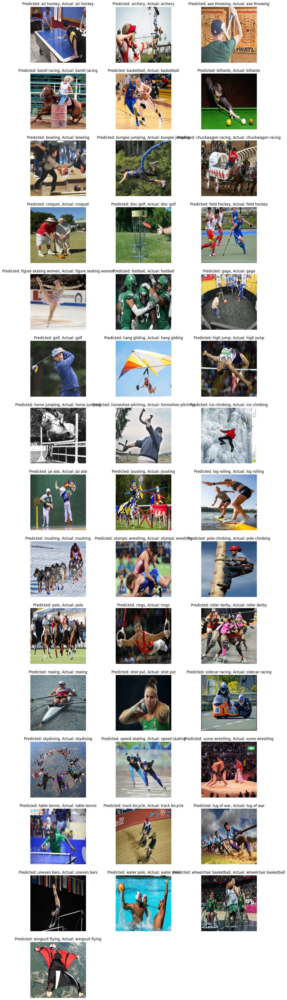

In [38]:
# Display correct predictions
correct_indices = np.where(y_pred == y_true)[0]

# The number of rows for a manageable number of images per row
num_cols = 3  # Number of images per row
num_rows = (len(correct_indices) // num_cols + 1) // 10 + 1

plt.figure(figsize=(num_cols*5, num_rows*4))

for i, idx in enumerate(correct_indices[::10]):
    plt.subplot(num_rows, num_cols, i+1)
    img = img_as_float(io.imread("" + str(test_df['filepaths'].iloc[idx])))
    plt.imshow(img)
    plt.title(f"Predicted: {class_names[y_pred[idx]]}, Actual: {class_names[y_true[idx]]}")
    plt.axis('off')  # Hide axis for better appearance

# Add space between subplots
plt.subplots_adjust(wspace=0.1, hspace=0.2)
plt.show()

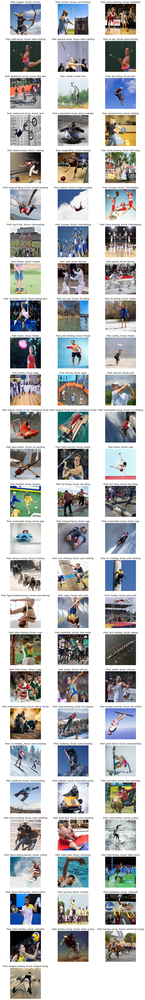

In [39]:
# Display correct predictions
incorrect_indices = np.where(y_pred != y_true)[0]

# The number of rows for a manageable number of images per row
num_cols = 3  # Number of images per row
num_rows = len(incorrect_indices) // num_cols + 1

plt.figure(figsize=(num_cols*5, num_rows*4))

for i, idx in enumerate(incorrect_indices):
    plt.subplot(num_rows, num_cols, i+1)
    img = img_as_float(io.imread("" + str(test_df['filepaths'].iloc[idx])))
    plt.imshow(img)
    plt.title(f"Pred: {class_names[y_pred[idx]]}, Actual: {class_names[y_true[idx]]}")
    plt.axis('off')  # Hide axis for better appearance

# Add space between subplots
plt.subplots_adjust(wspace=0.1, hspace=0.2)
plt.show()

---
# Underperforming classes
---

There are a few classes which are underperforming. Here are a few reasons for this misclassification:

- The background of the image is creating confusion.

    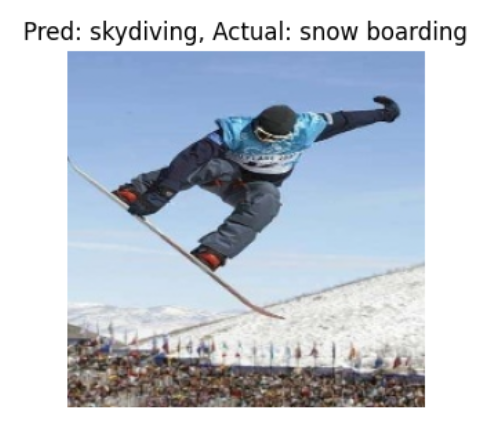

- The similarity between different sports creating the misclassification.

    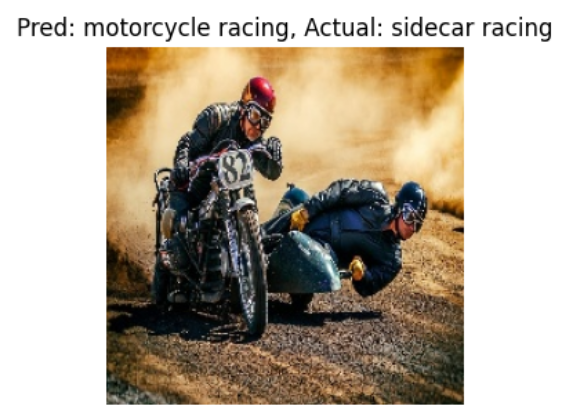 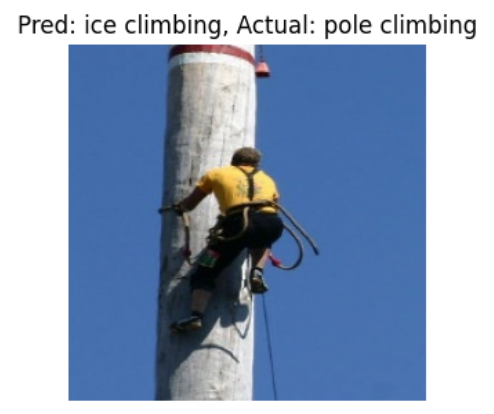

- Similar course of actions and elements in different sports.

    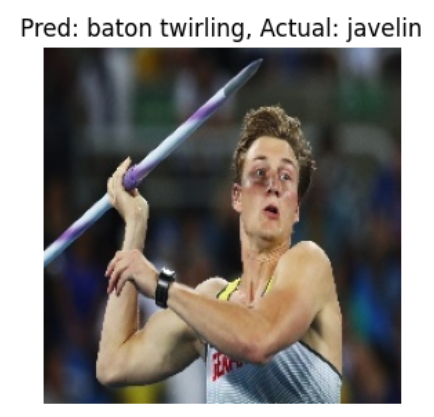 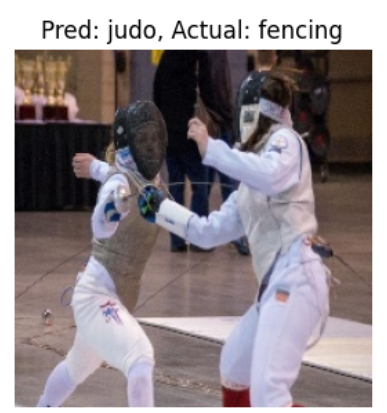 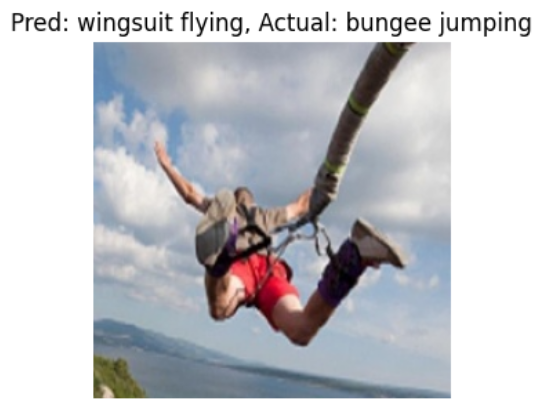 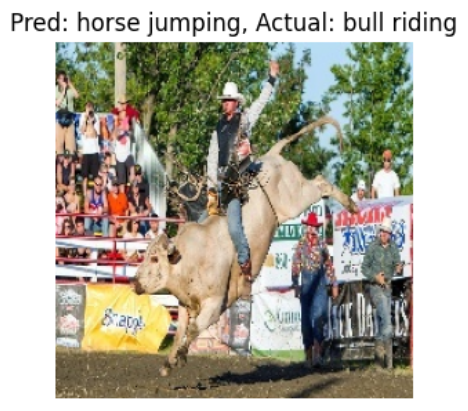

- Lack of training.

    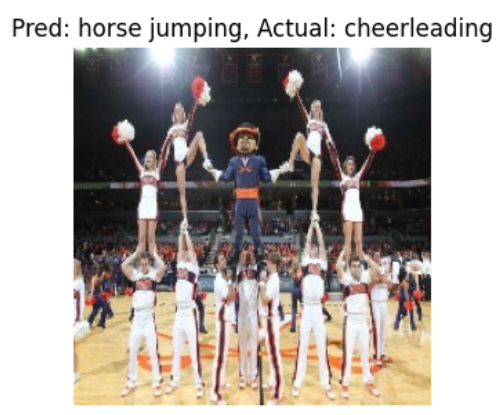 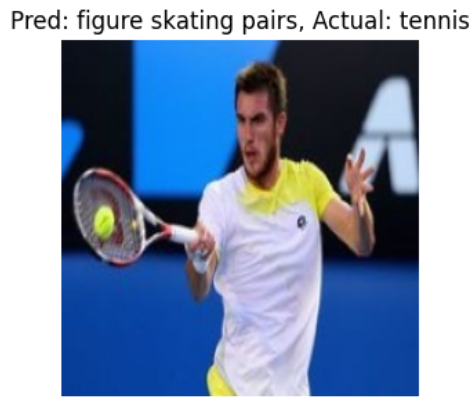


More hyperparameter tuning is still possible and a more tuned model may classify the misclassified images more accuracety. In this case, hyperparameter tuning frameworks may come handy.

---